### Import packages

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import copy
import math

%matplotlib inline

In [2]:
# pip install ydata-profiling
from ydata_profiling import ProfileReport

### Read data

In [3]:
data = pd.read_csv("smoking/smoking.csv", thousands=',', skipinitialspace=True)
data

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,...,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0
1,1,F,40,160,60,81.0,0.8,0.6,1.0,1.0,...,12.7,1.0,0.6,22.0,19.0,18.0,Y,0,Y,0
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,...,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N,1
3,3,M,40,165,70,88.0,1.5,1.5,1.0,1.0,...,14.7,1.0,1.0,19.0,26.0,18.0,Y,0,Y,0
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,...,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,F,40,170,65,75.0,0.9,0.9,1.0,1.0,...,12.3,1.0,0.6,14.0,7.0,10.0,Y,1,Y,0
55688,55681,F,45,160,50,70.0,1.2,1.2,1.0,1.0,...,14.0,1.0,0.9,20.0,12.0,14.0,Y,0,Y,0
55689,55683,F,55,160,50,68.5,1.0,1.2,1.0,1.0,...,12.4,1.0,0.5,17.0,11.0,12.0,Y,0,N,0
55690,55684,M,60,165,60,78.0,0.8,1.0,1.0,1.0,...,14.4,1.0,0.7,20.0,19.0,18.0,Y,0,N,0


### Drop empty lines in data and remove NAN's

In [4]:
data = data.dropna()
data

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,...,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0
1,1,F,40,160,60,81.0,0.8,0.6,1.0,1.0,...,12.7,1.0,0.6,22.0,19.0,18.0,Y,0,Y,0
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,...,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N,1
3,3,M,40,165,70,88.0,1.5,1.5,1.0,1.0,...,14.7,1.0,1.0,19.0,26.0,18.0,Y,0,Y,0
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,...,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,F,40,170,65,75.0,0.9,0.9,1.0,1.0,...,12.3,1.0,0.6,14.0,7.0,10.0,Y,1,Y,0
55688,55681,F,45,160,50,70.0,1.2,1.2,1.0,1.0,...,14.0,1.0,0.9,20.0,12.0,14.0,Y,0,Y,0
55689,55683,F,55,160,50,68.5,1.0,1.2,1.0,1.0,...,12.4,1.0,0.5,17.0,11.0,12.0,Y,0,N,0
55690,55684,M,60,165,60,78.0,0.8,1.0,1.0,1.0,...,14.4,1.0,0.7,20.0,19.0,18.0,Y,0,N,0


### Reset the index for potentially removed rows in data

In [5]:
data = data.reset_index(drop=True)

## EDA - Exploratory Data Analysis

### View data statistics - short format

In [6]:
data.describe()

,ID,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
count,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,...,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000
mean,27845.500000,44.182917,164.649321,65.864936,82.046418,1.012623,1.007443,1.025587,1.026144,121.494218,...,57.290347,114.964501,14.622592,1.087212,0.885738,26.182935,27.036037,39.952201,0.213334,0.367288
std,16077.039933,12.071418,9.194597,12.820306,9.274223,0.486873,0.485964,0.157902,0.159564,13.675989,...,14.738963,40.926476,1.564498,0.404882,0.221524,19.355460,30.947853,50.290539,0.409665,0.482070
min,0.000000,20.000000,130.000000,30.000000,51.000000,0.100000,0.100000,1.000000,1.000000,71.000000,...,4.000000,1.000000,4.900000,1.000000,0.100000,6.000000,1.000000,1.000000,0.000000,0.000000
25%,13922.750000,40.000000,160.000000,55.000000,76.000000,0.800000,0.800000,1.000000,1.000000,112.000000,...,47.000000,92.000000,13.600000,1.000000,0.800000,19.000000,15.000000,17.000000,0.000000,0.000000
50%,27845.500000,40.000000,165.000000,65.000000,82.000000,1.000000,1.000000,1.000000,1.000000,120.000000,...,55.000000,113.000000,14.800000,1.000000,0.900000,23.000000,21.000000,25.000000,0.000000,0.000000
75%,41768.250000,55.000000,170.000000,75.000000,88.000000,1.200000,1.200000,1.000000,1.000000,130.000000,...,66.000000,136.000000,15.800000,1.000000,1.000000,28.000000,31.000000,43.000000,0.000000,1.000000
max,55691.000000,85.000000,190.000000,135.000000,129.000000,9.900000,9.900000,2.000000,2.000000,240.000000,...,618.000000,1860.000000,21.100000,6.000000,11.600000,1311.000000,2914.000000,999.000000,1.000000,1.000000


### View data statistics - long format

In [7]:
profile = ProfileReport(data, title="Smoking")

In [8]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 37.34it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Important: We have 63.28% samples of non-smokers and 36.72% smoker samples in our dataset

### Change categorical string/boolean columns to categorical integer columns

In [9]:
data['gender'] = data['gender'].astype(str).str.strip().map({'F': 0, 'M': 1})
data['oral'] = data['oral'].astype(str).str.strip().map({'N': 0, 'Y': 1})
data['tartar'] = data['tartar'].astype(str).str.strip().map({'N': 0, 'Y': 1})

In [10]:
data

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,0,40,155,60,81.3,1.2,1.0,1.0,1.0,...,12.9,1.0,0.7,18.0,19.0,27.0,1,0,1,0
1,1,0,40,160,60,81.0,0.8,0.6,1.0,1.0,...,12.7,1.0,0.6,22.0,19.0,18.0,1,0,1,0
2,2,1,55,170,60,80.0,0.8,0.8,1.0,1.0,...,15.8,1.0,1.0,21.0,16.0,22.0,1,0,0,1
3,3,1,40,165,70,88.0,1.5,1.5,1.0,1.0,...,14.7,1.0,1.0,19.0,26.0,18.0,1,0,1,0
4,4,0,40,155,60,86.0,1.0,1.0,1.0,1.0,...,12.5,1.0,0.6,16.0,14.0,22.0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,0,40,170,65,75.0,0.9,0.9,1.0,1.0,...,12.3,1.0,0.6,14.0,7.0,10.0,1,1,1,0
55688,55681,0,45,160,50,70.0,1.2,1.2,1.0,1.0,...,14.0,1.0,0.9,20.0,12.0,14.0,1,0,1,0
55689,55683,0,55,160,50,68.5,1.0,1.2,1.0,1.0,...,12.4,1.0,0.5,17.0,11.0,12.0,1,0,0,0
55690,55684,1,60,165,60,78.0,0.8,1.0,1.0,1.0,...,14.4,1.0,0.7,20.0,19.0,18.0,1,0,0,0


### Create x and y from original data

In [11]:
x_data = data.drop(columns=['smoking'])
x_data

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar
0,0,0,40,155,60,81.3,1.2,1.0,1.0,1.0,...,126.0,12.9,1.0,0.7,18.0,19.0,27.0,1,0,1
1,1,0,40,160,60,81.0,0.8,0.6,1.0,1.0,...,127.0,12.7,1.0,0.6,22.0,19.0,18.0,1,0,1
2,2,1,55,170,60,80.0,0.8,0.8,1.0,1.0,...,151.0,15.8,1.0,1.0,21.0,16.0,22.0,1,0,0
3,3,1,40,165,70,88.0,1.5,1.5,1.0,1.0,...,226.0,14.7,1.0,1.0,19.0,26.0,18.0,1,0,1
4,4,0,40,155,60,86.0,1.0,1.0,1.0,1.0,...,107.0,12.5,1.0,0.6,16.0,14.0,22.0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,0,40,170,65,75.0,0.9,0.9,1.0,1.0,...,118.0,12.3,1.0,0.6,14.0,7.0,10.0,1,1,1
55688,55681,0,45,160,50,70.0,1.2,1.2,1.0,1.0,...,79.0,14.0,1.0,0.9,20.0,12.0,14.0,1,0,1
55689,55683,0,55,160,50,68.5,1.0,1.2,1.0,1.0,...,63.0,12.4,1.0,0.5,17.0,11.0,12.0,1,0,0
55690,55684,1,60,165,60,78.0,0.8,1.0,1.0,1.0,...,146.0,14.4,1.0,0.7,20.0,19.0,18.0,1,0,0


In [12]:
y_data = data[['smoking']]
y_data

,smoking
0,0
1,0
2,1
3,0
4,0
...,...
55687,0
55688,0
55689,0
55690,0


### Split data into training and validation datasets: Default 80% train, 20% validation

In [13]:
x_train, x_validation, y_train, y_validation = train_test_split(x_data, y_data, test_size=0.2, random_state=42, stratify=y_data)

### Visualize how one sample looks like

In [14]:
x_train = x_train.to_numpy()
x_validation = x_validation.to_numpy()
y_train = y_train.to_numpy()
y_validation = y_validation.to_numpy()

In [15]:
x_train[0]

array([4.2457e+04, 1.0000e+00, 4.5000e+01, 1.7000e+02, 6.5000e+01,
       8.5000e+01, 1.2000e+00, 1.2000e+00, 1.0000e+00, 1.0000e+00,
       1.4000e+02, 1.0000e+02, 9.6000e+01, 2.2200e+02, 2.1200e+02,
       4.0000e+01, 1.4000e+02, 1.5400e+01, 1.0000e+00, 1.5000e+00,
       4.1000e+01, 6.8000e+01, 3.4000e+01, 1.0000e+00, 0.0000e+00,
       1.0000e+00])

### Visualize the number of training samples and number of validation samples

In [16]:
len(y_train), len(y_validation)

(44553, 11139)

### Visualize the number of no churn vs churn samples in training dataset

#### Having 63.28% samples of non-smokers and 36.72% samples of smokers in our dataset
#### So we have a ratio of 2 non-smoker samples to 1 smoker sample
#### Our training and validation dataset should respect this ratio approximately

In [17]:
np.unique(y_train, return_counts=True)

(array([0, 1]), array([28189, 16364]))

In [18]:
np.unique(y_validation, return_counts=True)

(array([0, 1]), array([7048, 4091]))

### Standardization - mean and standard deviation calculation

In [19]:
mean   = np.mean(x_train, axis=0)
sigma  = np.std(x_train, axis=0)
sigma[sigma == 0] = 1

In [20]:
x_train = (x_train - mean) / sigma
x_train = np.nan_to_num(x_train)

### Very important! Validation dataset MUST BE standardized using mean and standard deviation calculated from the training dataset

In [21]:
x_validation = (x_validation - mean) / sigma
x_validation = np.nan_to_num(x_validation)

### View min and max values after standardization from training dataset

In [22]:
x_train.min(), x_train.max()

(np.float64(-6.197832388219651), np.float64(92.54473898750784))

### View min and max values after standardization from training dataset

In [23]:
x_validation.min(), x_validation.max()

(np.float64(-5.815255477992158), np.float64(66.60182593754459))

### Logistic Regression implementation

In [24]:
def sigmoid(x):
    x = np.clip(x, -500, 500)
    return 1 / (1 + np.exp(-x))

#### Examples of using sigmoid values

In [25]:
sigmoid(1)

np.float64(0.7310585786300049)

In [26]:
sigmoid(0)

np.float64(0.5)

In [27]:
sigmoid(-1)

np.float64(0.2689414213699951)

In [28]:
sigmoid(100)

np.float64(1.0)

In [29]:
def compute_cost(X, y, w, b, lambda_=1):
    m = X.shape[0]
    cost = 0.0
    for i in range(m):
        z_i = np.dot(X[i],w) + b
        f_wb_i = np.clip(sigmoid(z_i), 1e-15, 1 - 1e-15)
        cost +=  -y[i] * np.log(f_wb_i) - (1 - y[i]) * np.log(1 - f_wb_i) 
             
    cost = cost / m
    return cost

In [30]:
def compute_gradient(X, y, w, b, lambda_=1):
    m,n = X.shape
    dj_dw = np.zeros((n,))                           #(n,)
    dj_db = 0.

    for i in range(m):
        f_wb_i = sigmoid(np.dot(X[i], w) + b)          #(n,)(n,)=scalar
        err_i  = f_wb_i  - y[i]                       #scalar
        for j in range(n):
            dj_dw[j] += (err_i * X[i, j]).item()
        dj_db += err_i
    dj_dw = dj_dw/m                                   #(n,)
    dj_db = dj_db/m                                   #scalar
        
    return dj_db, dj_dw

In [31]:
def gradient_descent(x_train, y_train, x_validation, y_validation, w_in, b_in, cost_function, gradient_function, alpha, num_iters, lambda_=1):    
    # number of training examples
    m = len(x_train)
    
    # An array to store cost J and w's at each iteration primarily for graphing later
    J_train_history = []
    J_valid_history = []
    w_history = []

    best_train_score = cost_function(x_train, y_train, w_in, b_in, lambda_)
    best_validation_score = cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
    best_w_in_train = copy.deepcopy(w_in)
    best_b_train = copy.deepcopy(b_in)
    best_w_in_valid = copy.deepcopy(w_in)
    best_b_valid = copy.deepcopy(b_in)
    os.makedirs("model", exist_ok=True)

    for i in range(num_iters):
        
        # Calculate the gradient and update the parameters
        dj_db, dj_dw = gradient_function(x_train, y_train, w_in, b_in, lambda_)   

        # Update Parameters using w, b, alpha and gradient
        w_in = w_in - alpha * dj_dw               
        b_in = b_in - alpha * dj_db              
        
        cost_train =  cost_function(x_train, y_train, w_in, b_in, lambda_)
        J_train_history.append(cost_train)

        cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
        J_valid_history.append(cost_valid)

        if best_train_score > cost_train:
            best_train_score = cost_train
            np.save(f'model/best_train_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_train_b.npy', b_in) 


        if best_validation_score > cost_valid:
            best_validation_score = cost_valid
            np.save(f'model/best_valid_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_valid_b.npy', b_in) 
        
        # Print cost every at intervals 10 times or as many iterations if < 10
        if i % math.ceil(num_iters/10) == 0 or i == (num_iters-1):
            w_history.append(w_in)
            print(f"Iteration {i:4}: Cost Train: {float(J_train_history[-1].squeeze()):f} \t  Cost Validation: {float(J_valid_history[-1].squeeze()):f}")
        
    return w_in, b_in, J_train_history, J_valid_history, w_history #return w and J,w history for graphing

In [32]:
import os

In [33]:
initial_w = np.zeros(len(x_train[0]))
initial_b = 0

# Some gradient descent settings
iterations = 100
alpha = 0.1
lambda_ = 0

w_final, b_final, J_train_history, J_valid_history, _ = gradient_descent(x_train=x_train, y_train=y_train, x_validation=x_validation, y_validation=y_validation, w_in=initial_w, b_in=initial_b, cost_function=compute_cost, gradient_function=compute_gradient, alpha=alpha, num_iters=iterations, lambda_=lambda_)

Iteration    0: Cost Train: 0.668907 	  Cost Validation: 0.668928
Iteration   10: Cost Train: 0.569610 	  Cost Validation: 0.569935
Iteration   20: Cost Train: 0.541266 	  Cost Validation: 0.541882
Iteration   30: Cost Train: 0.525951 	  Cost Validation: 0.526818
Iteration   40: Cost Train: 0.515582 	  Cost Validation: 0.516660
Iteration   50: Cost Train: 0.507998 	  Cost Validation: 0.509245
Iteration   60: Cost Train: 0.502241 	  Cost Validation: 0.503631
Iteration   70: Cost Train: 0.497763 	  Cost Validation: 0.499283
Iteration   80: Cost Train: 0.494210 	  Cost Validation: 0.495854
Iteration   90: Cost Train: 0.491343 	  Cost Validation: 0.493111
Iteration   99: Cost Train: 0.489210 	  Cost Validation: 0.491089


In [34]:
best_w_final = np.load('model/best_valid_w_in.npy')
best_b_final = np.load('model/best_valid_b.npy')

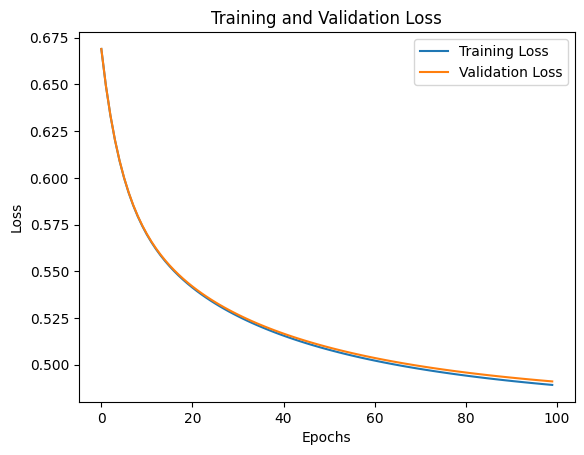

In [35]:
# Generate a sequence of integers to represent the epoch numbers
#epochs = range(1, iterations+1)
 
# Plot and label the training and validation loss values
plt.plot(J_train_history, label='Training Loss')
plt.plot(J_valid_history, label='Validation Loss')
 
# Add in a title and axes labels
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
 
# Set the tick locations
#plt.xticks(np.arange(0, iterations+1, 2))
 
# Display the plot
plt.legend(loc='best')
plt.show()

In [36]:
def predict(X, w, b):
    # number of training examples
    m, n = X.shape   
    p = np.zeros(m)
    
    for i in range(m):   
        z_wb = 0
        # Loop over each feature
        for j in range(n): 
            # Add the corresponding term to z_wb
            z_wb += X[i][j] * w[j]
        
        # Add bias term 
        z_wb += b
        
        # Calculate the prediction for this example
        f_wb = sigmoid(z_wb)

        # Apply the threshold
        p[i] = (f_wb >= 0.5).item()
        
    return p

In [37]:
y_predicted = predict(x_train, w_final, b_final)

In [38]:
y_train.shape

(44553, 1)

In [39]:
y_train.reshape(-1).shape, y_predicted.shape

((44553,), (44553,))

In [40]:
(y_train.reshape(-1) == y_predicted).sum()

np.int64(32636)

In [41]:
x_train.shape
x_train.shape

(44553, 26)

In [42]:
y_train = y_train.reshape(-1)

In [43]:
type(y_predicted)

numpy.ndarray

In [44]:
def metrics_computations(x:np.array,
                         y_true:np.array,
                         y_predicted: np.array):
    total_number_of_samples = x.shape[0]
    accuracy = (y_true == y_predicted).sum() / total_number_of_samples
    true_positive = ((y_predicted == 1) & (y_true == 1)).sum()
    false_positive = ((y_predicted == 1) & (y_true == 0)).sum()
    false_negative = ((y_predicted == 0) & (y_true == 1)).sum()
    true_negative = ((y_predicted == 0) & (y_true == 0)).sum()
    
    precision = true_positive / (true_positive + false_positive)
    recall = true_positive / (true_positive + false_negative)
    specificity = true_negative / (true_negative + false_positive)
    f1_score = (2 * precision * recall) / (precision + recall)
    
    false_negative_rate = false_negative / (false_negative + true_positive)
    false_positive_rate = false_positive / (false_positive + true_negative)

    return (accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate)

In [45]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train,
                                                                                                                     y_predicted=y_predicted)

In [46]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 73.25% 
 Precision: 61.79% 
 Recall: 71.19% 
 F1 Score: 66.16% 
 Specificity: 74.45% 
 False Positive Rate: 25.55% 
 False Negative Rate: 28.81%


In [47]:
y_predicted_validation = predict(x_validation, w_final, b_final)

In [48]:
y_validation = y_validation.reshape(-1)

In [49]:
for i, j in zip(y_validation, y_predicted_validation):
    print(i, j)

0 0.0
0 0.0
0 0.0
1 1.0
0 0.0
1 1.0
0 0.0
0 0.0
0 1.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 1.0
1 1.0
1 0.0
1 1.0
0 0.0
1 1.0
1 1.0
0 0.0
1 1.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 1.0
0 0.0
0 0.0
0 0.0
1 0.0
1 1.0
1 1.0
0 1.0
0 1.0
1 0.0
0 0.0
1 1.0
0 0.0
0 1.0
0 1.0
0 0.0
1 0.0
1 0.0
1 1.0
0 0.0
0 0.0
0 0.0
1 1.0
1 1.0
1 1.0
0 0.0
0 0.0
1 0.0
0 0.0
1 1.0
0 0.0
0 0.0
0 1.0
0 0.0
0 0.0
0 0.0
1 1.0
1 0.0
1 1.0
1 1.0
1 1.0
0 1.0
1 1.0
1 1.0
1 1.0
0 0.0
0 1.0
1 1.0
0 0.0
1 1.0
0 0.0
1 1.0
0 0.0
0 0.0
0 0.0
1 0.0
0 1.0
1 1.0
0 0.0
0 1.0
0 0.0
0 1.0
1 1.0
0 0.0
0 1.0
0 0.0
0 0.0
1 1.0
0 0.0
0 1.0
1 0.0
0 1.0
0 0.0
0 1.0
1 1.0
0 0.0
0 0.0
0 0.0
0 1.0
1 1.0
0 0.0
1 1.0
0 1.0
0 1.0
0 1.0
0 0.0
0 1.0
0 1.0
0 0.0
1 1.0
1 0.0
0 0.0
1 1.0
0 0.0
1 1.0
0 0.0
1 1.0
0 0.0
1 1.0
0 0.0
0 1.0
0 0.0
0 1.0
1 1.0
0 0.0
1 1.0
1 1.0
1 0.0
0 0.0
1 1.0
0 0.0
1 1.0
0 0.0
1 1.0
1 1.0
1 1.0
0 0.0
1 0.0
1 0.0
0 0.0
0 0.0
0 1.0
0 1.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 1.0
1 0.0
0 1.0
0 0.0
1 1.0
1 1.

In [50]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation,
                                                                                                                     y_predicted=y_predicted_validation)

In [51]:
print(f"[Valid] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[Valid] Accuracy: 73.25% 
 Precision: 61.68% 
 Recall: 71.72% 
 F1 Score: 66.32% 
 Specificity: 74.13% 
 False Positive Rate: 25.87% 
 False Negative Rate: 28.28%


### Analyze the feature importance

<Axes: ylabel='Feature'>

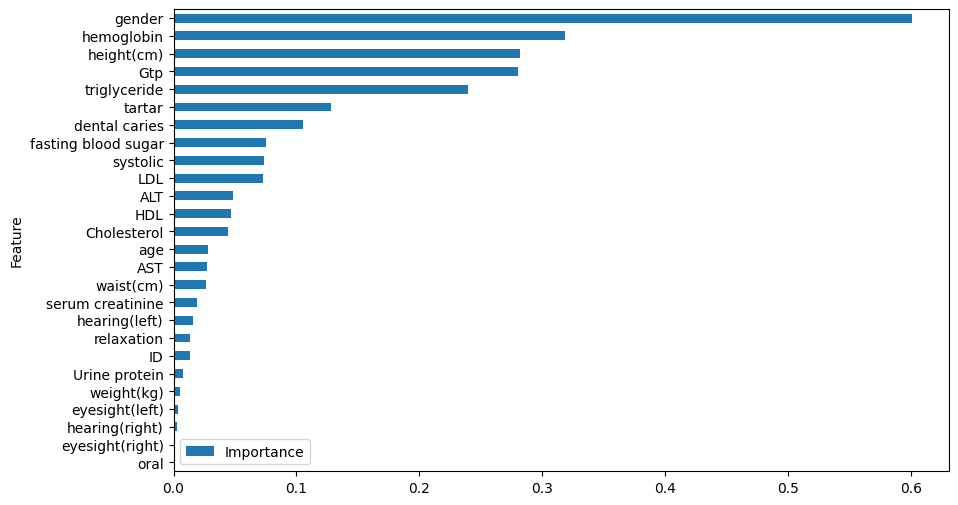

In [52]:
coefficients = copy.deepcopy(w_final)

feature_importance = pd.DataFrame({'Feature': x_data.columns.values, 'Importance': np.abs(coefficients)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(10, 6))

### Add polynomial features for improving model capacity

In [53]:
#pip install scikit-learn
from sklearn import preprocessing

In [54]:
poly = preprocessing.PolynomialFeatures(2, interaction_only=False, include_bias=False)

In [55]:
poly_values = poly.fit_transform(x_data)
poly_values

array([[0.0000e+00, 0.0000e+00, 4.0000e+01, ..., 0.0000e+00, 0.0000e+00,
        1.0000e+00],
       [1.0000e+00, 0.0000e+00, 4.0000e+01, ..., 0.0000e+00, 0.0000e+00,
        1.0000e+00],
       [2.0000e+00, 1.0000e+00, 5.5000e+01, ..., 0.0000e+00, 0.0000e+00,
        0.0000e+00],
       ...,
       [5.5683e+04, 0.0000e+00, 5.5000e+01, ..., 0.0000e+00, 0.0000e+00,
        0.0000e+00],
       [5.5684e+04, 1.0000e+00, 6.0000e+01, ..., 0.0000e+00, 0.0000e+00,
        0.0000e+00],
       [5.5691e+04, 1.0000e+00, 5.5000e+01, ..., 0.0000e+00, 0.0000e+00,
        1.0000e+00]])

In [56]:
poly_column_names = list(poly.get_feature_names_out(x_data.columns))
poly_column_names

['ID',
 'gender',
 'age',
 'height(cm)',
 'weight(kg)',
 'waist(cm)',
 'eyesight(left)',
 'eyesight(right)',
 'hearing(left)',
 'hearing(right)',
 'systolic',
 'relaxation',
 'fasting blood sugar',
 'Cholesterol',
 'triglyceride',
 'HDL',
 'LDL',
 'hemoglobin',
 'Urine protein',
 'serum creatinine',
 'AST',
 'ALT',
 'Gtp',
 'oral',
 'dental caries',
 'tartar',
 'ID^2',
 'ID gender',
 'ID age',
 'ID height(cm)',
 'ID weight(kg)',
 'ID waist(cm)',
 'ID eyesight(left)',
 'ID eyesight(right)',
 'ID hearing(left)',
 'ID hearing(right)',
 'ID systolic',
 'ID relaxation',
 'ID fasting blood sugar',
 'ID Cholesterol',
 'ID triglyceride',
 'ID HDL',
 'ID LDL',
 'ID hemoglobin',
 'ID Urine protein',
 'ID serum creatinine',
 'ID AST',
 'ID ALT',
 'ID Gtp',
 'ID oral',
 'ID dental caries',
 'ID tartar',
 'gender^2',
 'gender age',
 'gender height(cm)',
 'gender weight(kg)',
 'gender waist(cm)',
 'gender eyesight(left)',
 'gender eyesight(right)',
 'gender hearing(left)',
 'gender hearing(right)',


In [57]:
x_data = pd.DataFrame(poly_values, columns=poly_column_names)
x_data

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,Gtp^2,Gtp oral,Gtp dental caries,Gtp tartar,oral^2,oral dental caries,oral tartar,dental caries^2,dental caries tartar,tartar^2
0,0.0,0.0,40.0,155.0,60.0,81.3,1.2,1.0,1.0,1.0,...,729.0,27.0,0.0,27.0,1.0,0.0,1.0,0.0,0.0,1.0
1,1.0,0.0,40.0,160.0,60.0,81.0,0.8,0.6,1.0,1.0,...,324.0,18.0,0.0,18.0,1.0,0.0,1.0,0.0,0.0,1.0
2,2.0,1.0,55.0,170.0,60.0,80.0,0.8,0.8,1.0,1.0,...,484.0,22.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,3.0,1.0,40.0,165.0,70.0,88.0,1.5,1.5,1.0,1.0,...,324.0,18.0,0.0,18.0,1.0,0.0,1.0,0.0,0.0,1.0
4,4.0,0.0,40.0,155.0,60.0,86.0,1.0,1.0,1.0,1.0,...,484.0,22.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676.0,0.0,40.0,170.0,65.0,75.0,0.9,0.9,1.0,1.0,...,100.0,10.0,10.0,10.0,1.0,1.0,1.0,1.0,1.0,1.0
55688,55681.0,0.0,45.0,160.0,50.0,70.0,1.2,1.2,1.0,1.0,...,196.0,14.0,0.0,14.0,1.0,0.0,1.0,0.0,0.0,1.0
55689,55683.0,0.0,55.0,160.0,50.0,68.5,1.0,1.2,1.0,1.0,...,144.0,12.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
55690,55684.0,1.0,60.0,165.0,60.0,78.0,0.8,1.0,1.0,1.0,...,324.0,18.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [58]:
x_data.columns

Index(['ID', 'gender', 'age', 'height(cm)', 'weight(kg)', 'waist(cm)',
       'eyesight(left)', 'eyesight(right)', 'hearing(left)', 'hearing(right)',
       ...
       'Gtp^2', 'Gtp oral', 'Gtp dental caries', 'Gtp tartar', 'oral^2',
       'oral dental caries', 'oral tartar', 'dental caries^2',
       'dental caries tartar', 'tartar^2'],
      dtype='object', length=377)

### Split data into training and validation datasets: Default 80% train, 20% validation

In [59]:
x_train, x_validation, y_train, y_validation = train_test_split(x_data, y_data, test_size=0.2, random_state=42, stratify=y_data)

In [60]:
x_train = x_train.to_numpy()
x_validation = x_validation.to_numpy()
y_train = y_train.to_numpy()
y_validation = y_validation.to_numpy()

### Visualize how one sample looks like

In [61]:
x_train[0]

array([4.24570000e+04, 1.00000000e+00, 4.50000000e+01, 1.70000000e+02,
       6.50000000e+01, 8.50000000e+01, 1.20000000e+00, 1.20000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.40000000e+02, 1.00000000e+02,
       9.60000000e+01, 2.22000000e+02, 2.12000000e+02, 4.00000000e+01,
       1.40000000e+02, 1.54000000e+01, 1.00000000e+00, 1.50000000e+00,
       4.10000000e+01, 6.80000000e+01, 3.40000000e+01, 1.00000000e+00,
       0.00000000e+00, 1.00000000e+00, 1.80259685e+09, 4.24570000e+04,
       1.91056500e+06, 7.21769000e+06, 2.75970500e+06, 3.60884500e+06,
       5.09484000e+04, 5.09484000e+04, 4.24570000e+04, 4.24570000e+04,
       5.94398000e+06, 4.24570000e+06, 4.07587200e+06, 9.42545400e+06,
       9.00088400e+06, 1.69828000e+06, 5.94398000e+06, 6.53837800e+05,
       4.24570000e+04, 6.36855000e+04, 1.74073700e+06, 2.88707600e+06,
       1.44353800e+06, 4.24570000e+04, 0.00000000e+00, 4.24570000e+04,
       1.00000000e+00, 4.50000000e+01, 1.70000000e+02, 6.50000000e+01,
      

### Visualize the nuber of training samples and number of validation samples

In [62]:
len(y_train), len(y_validation)

(44553, 11139)

In [63]:
np.unique(y_train, return_counts=True)

(array([0, 1]), array([28189, 16364]))

In [64]:
np.unique(y_validation, return_counts=True)

(array([0, 1]), array([7048, 4091]))

### Standardization - mean and standard deviation calculation

In [65]:
mean   = np.mean(x_train, axis=0)
sigma  = np.std(x_train, axis=0)
sigma[sigma == 0] = 1

In [66]:
x_train = (x_train - mean) / sigma
x_train = np.nan_to_num(x_train)

### Very important! Validation dataset MUST BE standardized using mean and standard deviation calculated from the training dataset

In [67]:
x_validation = (x_validation - mean) / sigma
x_validation = np.nan_to_num(x_validation)

### View min and max values after standardization from training dataset

In [68]:
x_train.min(), x_train.max()

(np.float64(-6.197832388219347), np.float64(173.48874617601737))

### View min and max values after standardization from training dataset

In [69]:
x_validation.min(), x_validation.max()

(np.float64(-5.815255477991867), np.float64(197.26286450078334))

### Train with polynomial features

In [70]:
def gradient_descent(x_train, y_train, x_validation, y_validation, w_in, b_in, cost_function, gradient_function, alpha, num_iters, lambda_=1):    
    # number of training examples
    m = len(x_train)
    
    # An array to store cost J and w's at each iteration primarily for graphing later
    J_train_history = []
    J_valid_history = []
    w_history = []

    best_train_score = cost_function(x_train, y_train, w_in, b_in, lambda_)
    best_validation_score = cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
    best_w_in_train = copy.deepcopy(w_in)
    best_b_train = copy.deepcopy(b_in)
    best_w_in_valid = copy.deepcopy(w_in)
    best_b_valid = copy.deepcopy(b_in)
    
    for i in range(num_iters):
        
        # Calculate the gradient and update the parameters
        dj_db, dj_dw = gradient_function(x_train, y_train, w_in, b_in, lambda_)   

        # Update Parameters using w, b, alpha and gradient
        w_in = w_in - alpha * dj_dw               
        b_in = b_in - alpha * dj_db              
        
        cost_train =  cost_function(x_train, y_train, w_in, b_in, lambda_)
        J_train_history.append(cost_train)

        cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
        J_valid_history.append(cost_valid)

        if best_train_score > cost_train:
            best_train_score = cost_train
            np.save(f'model/best_poly_train_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_poly_train_b.npy', b_in) 


        if best_validation_score > cost_valid:
            best_validation_score = cost_valid
            np.save(f'model/best_poly_valid_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_poly_valid_b.npy', b_in) 
        
        # Print cost every at intervals 10 times or as many iterations if < 10
        if i % math.ceil(num_iters/10) == 0 or i == (num_iters-1):
            w_history.append(w_in)
            print(f"Iteration {i:4}: Cost Train: {float(J_train_history[-1].squeeze()):f} \t  Cost Validation: {float(J_valid_history[-1].squeeze()):f}")
        
    return w_in, b_in, J_train_history, J_valid_history, w_history #return w and J,w history for graphing

In [71]:
initial_w = np.zeros(len(x_train[0]))
initial_b = 0

# Some gradient descent settings
iterations = 100
alpha = 0.1
lambda_ = 0

w_final, b_final, J_train_history, J_valid_history, _ = gradient_descent(x_train=x_train, y_train=y_train, x_validation=x_validation, y_validation=y_validation, w_in=initial_w, b_in=initial_b, cost_function=compute_cost, gradient_function=compute_gradient, alpha=alpha, num_iters=iterations, lambda_=lambda_)

Iteration    0: Cost Train: 0.571293 	  Cost Validation: 0.569208
Iteration   10: Cost Train: 0.518974 	  Cost Validation: 0.520668
Iteration   20: Cost Train: 0.505685 	  Cost Validation: 0.508482
Iteration   30: Cost Train: 0.496971 	  Cost Validation: 0.500222
Iteration   40: Cost Train: 0.490645 	  Cost Validation: 0.494128
Iteration   50: Cost Train: 0.485915 	  Cost Validation: 0.489545
Iteration   60: Cost Train: 0.482310 	  Cost Validation: 0.486057
Iteration   70: Cost Train: 0.479518 	  Cost Validation: 0.483366
Iteration   80: Cost Train: 0.477322 	  Cost Validation: 0.481264
Iteration   90: Cost Train: 0.475569 	  Cost Validation: 0.479599
Iteration   99: Cost Train: 0.474279 	  Cost Validation: 0.478384


In [72]:
best_poly_w_final = np.load('model/best_poly_valid_w_in.npy')
best_poly_b_final = np.load('model/best_poly_valid_b.npy')

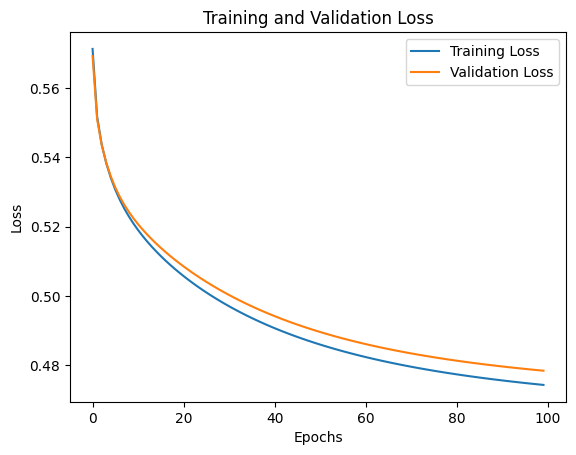

In [73]:
# Generate a sequence of integers to represent the epoch numbers
#epochs = range(1, iterations+1)
 
# Plot and label the training and validation loss values
plt.plot(J_train_history, label='Training Loss')
plt.plot(J_valid_history, label='Validation Loss')
 
# Add in a title and axes labels
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
 
# Set the tick locations
#plt.xticks(np.arange(0, iterations+1, 2))
 
# Display the plot
plt.legend(loc='best')
plt.show()

In [124]:
def predict(X, w, b):
    # number of training examples
    m, n = X.shape   
    p = np.zeros(m)
    
    for i in range(m):   
        z_wb = 0
        # Loop over each feature
        for j in range(n): 
            # Add the corresponding term to z_wb
            z_wb += X[i][j] * w[j]
        
        # Add bias term 
        z_wb += b
        
        # Calculate the prediction for this example
        f_wb = sigmoid(z_wb)

        # Apply the threshold
        p[i] = int((f_wb >= 0.5).item())
    return p

In [125]:
y_predicted = predict(x_train, w_final, b_final)

In [126]:
y_train.shape

(44553,)

In [127]:
y_train.reshape(-1).shape, y_predicted.shape

((44553,), (44553,))

In [128]:
(y_train.reshape(-1) == y_predicted).sum()

np.int64(27792)

In [129]:
y_train = y_train.reshape(-1)

In [130]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train,
                                                                                                                     y_predicted=y_predicted)

In [131]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 62.38% 
 Precision: 45.09% 
 Recall: 11.13% 
 F1 Score: 17.85% 
 Specificity: 92.13% 
 False Positive Rate: 7.87% 
 False Negative Rate: 88.87%


In [132]:
y_predicted_validation = predict(x_validation, w_final, b_final)

In [133]:
y_validation = y_validation.reshape(-1)

In [134]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation,
                                                                                                                     y_predicted=y_predicted_validation)

In [135]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 62.34% 
 Precision: 44.83% 
 Recall: 11.02% 
 F1 Score: 17.70% 
 Specificity: 92.13% 
 False Positive Rate: 7.87% 
 False Negative Rate: 88.98%


### Analyze the feature importance

<Axes: ylabel='Feature'>

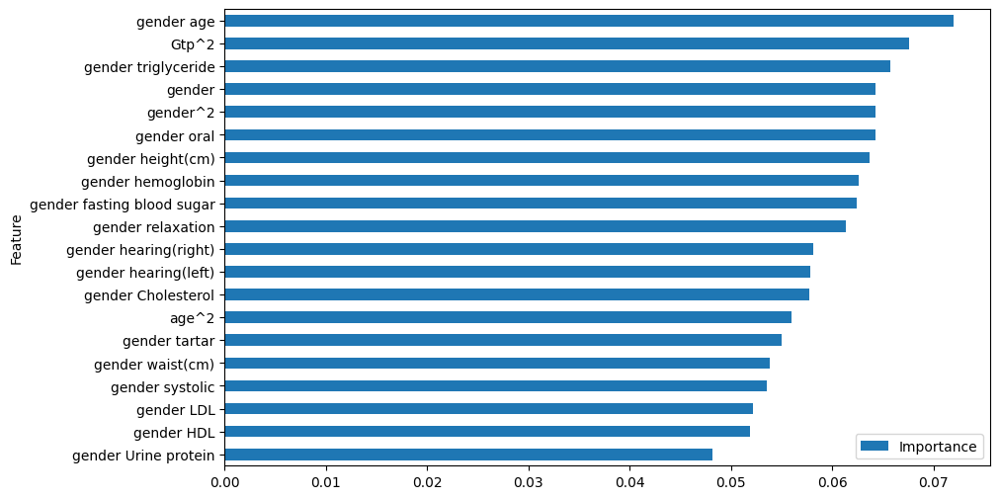

In [86]:
coefficients = copy.deepcopy(w_final)

feature_importance = pd.DataFrame({'Feature': x_data.columns.values, 'Importance': np.abs(coefficients)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.tail(20).plot(x='Feature', y='Importance', kind='barh', figsize=(10, 6))

### Decision Tree 
#### Specialized in learning non-linear data
#### No need for Normalization/Standardization
#### No need for Polynomial Feature Transformation

In [87]:
x_data = data.drop(columns=['smoking'])

### Split data into training and validation datasets: Default 80% train, 20% validation

In [88]:
x_train, x_validation, y_train, y_validation = train_test_split(x_data, y_data, test_size=0.2, random_state=42, stratify=y_data)

In [89]:
x_train = x_train.to_numpy()
x_validation = x_validation.to_numpy()
y_train = y_train.to_numpy()
y_validation = y_validation.to_numpy()

### Visualize how one sample looks like

In [90]:
x_train[0]

array([4.2457e+04, 1.0000e+00, 4.5000e+01, 1.7000e+02, 6.5000e+01,
       8.5000e+01, 1.2000e+00, 1.2000e+00, 1.0000e+00, 1.0000e+00,
       1.4000e+02, 1.0000e+02, 9.6000e+01, 2.2200e+02, 2.1200e+02,
       4.0000e+01, 1.4000e+02, 1.5400e+01, 1.0000e+00, 1.5000e+00,
       4.1000e+01, 6.8000e+01, 3.4000e+01, 1.0000e+00, 0.0000e+00,
       1.0000e+00])

### Visualize the nuber of training samples and number of validation samples

In [91]:
len(y_train), len(y_validation)

(44553, 11139)

In [92]:
np.unique(y_train, return_counts=True)

(array([0, 1]), array([28189, 16364]))

In [93]:
np.unique(y_validation, return_counts=True)

(array([0, 1]), array([7048, 4091]))

In [94]:
from sklearn.tree import DecisionTreeClassifier, export_text
from sklearn.metrics import accuracy_score

### Decision Tree Code and Implementation

#### Declare Decision Tree with corresponding Hyperparameters

In [95]:
classifier = DecisionTreeClassifier(criterion='entropy', min_samples_split=2, max_depth=5)

In [96]:
type(x_train)

numpy.ndarray

#### Train the Decision Tree

In [97]:
classifier.fit(x_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=5)

#### Predict on the training dataset 

In [98]:
y_predicted = classifier.predict(x_train)
y_predicted = np.array(y_predicted)

### Display training metrics

In [99]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train.reshape(-1),
                                                                                                                     y_predicted=y_predicted)

In [100]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 74.18% 
 Precision: 61.79% 
 Recall: 77.84% 
 F1 Score: 68.89% 
 Specificity: 72.06% 
 False Positive Rate: 27.94% 
 False Negative Rate: 22.16%


### Display validation metrics

In [101]:
y_predicted_valid = classifier.predict(x_validation)
y_predicted_valid = np.array(y_predicted_valid)

In [102]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation.reshape(-1),
                                                                                                                     y_predicted=y_predicted_valid)

In [103]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 74.41% 
 Precision: 62.10% 
 Recall: 77.80% 
 F1 Score: 69.07% 
 Specificity: 72.43% 
 False Positive Rate: 27.57% 
 False Negative Rate: 22.20%


### Display Decision Tree and Learned rules by the Tree 

In [104]:
list(x_data.columns)

['ID',
 'gender',
 'age',
 'height(cm)',
 'weight(kg)',
 'waist(cm)',
 'eyesight(left)',
 'eyesight(right)',
 'hearing(left)',
 'hearing(right)',
 'systolic',
 'relaxation',
 'fasting blood sugar',
 'Cholesterol',
 'triglyceride',
 'HDL',
 'LDL',
 'hemoglobin',
 'Urine protein',
 'serum creatinine',
 'AST',
 'ALT',
 'Gtp',
 'oral',
 'dental caries',
 'tartar']

In [105]:
from sklearn.tree import plot_tree


In [106]:
fig, axes = plt.subplots(nrows = 1,ncols = 1, figsize=(70,50), dpi=300)
plot_tree(classifier, filled=True, fontsize=20, feature_names=list(x_data.columns),rounded=True, ax=axes)
plt.savefig('decisionTree.png')

In [107]:
text_representation = export_text(classifier, feature_names=list(x_data.columns), class_names=['No Smoking', 'Smoking'])
print(text_representation)

|--- gender <= 0.50
|   |--- Gtp <= 23.50
|   |   |--- systolic <= 106.50
|   |   |   |--- AST <= 18.50
|   |   |   |   |--- ALT <= 5.50
|   |   |   |   |   |--- class: No Smoking
|   |   |   |   |--- ALT >  5.50
|   |   |   |   |   |--- class: No Smoking
|   |   |   |--- AST >  18.50
|   |   |   |   |--- Gtp <= 15.50
|   |   |   |   |   |--- class: No Smoking
|   |   |   |   |--- Gtp >  15.50
|   |   |   |   |   |--- class: No Smoking
|   |   |--- systolic >  106.50
|   |   |   |--- Gtp <= 15.50
|   |   |   |   |--- age <= 22.50
|   |   |   |   |   |--- class: No Smoking
|   |   |   |   |--- age >  22.50
|   |   |   |   |   |--- class: No Smoking
|   |   |   |--- Gtp >  15.50
|   |   |   |   |--- systolic <= 130.50
|   |   |   |   |   |--- class: No Smoking
|   |   |   |   |--- systolic >  130.50
|   |   |   |   |   |--- class: No Smoking
|   |--- Gtp >  23.50
|   |   |--- age <= 47.50
|   |   |   |--- triglyceride <= 135.50
|   |   |   |   |--- tartar <= 0.50
|   |   |   |   |   |---

In [108]:
from sklearn.tree import _tree

In [109]:
def get_rules(tree, feature_names, class_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]

    paths = []
    path = []
    
    def recurse(node, path, paths):
        
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            p1, p2 = list(path), list(path)
            p1 += [f"({name} <= {np.round(threshold, 3)})"]
            recurse(tree_.children_left[node], p1, paths)
            p2 += [f"({name} > {np.round(threshold, 3)})"]
            recurse(tree_.children_right[node], p2, paths)
        else:
            path += [(tree_.value[node], tree_.n_node_samples[node])]
            paths += [path]
            
    recurse(0, path, paths)

    # sort by samples count
    samples_count = [p[-1][1] for p in paths]
    ii = list(np.argsort(samples_count))
    paths = [paths[i] for i in reversed(ii)]
    
    rules = []
    for path in paths:
        rule = "if "
        
        for p in path[:-1]:
            if rule != "if ":
                rule += " and "
            rule += str(p)
        rule += " then "
        if class_names is None:
            rule += "response: "+str(np.round(path[-1][0][0][0],3))
        else:
            classes = path[-1][0][0]
            l = np.argmax(classes)
            rule += f"class: {class_names[l]} (proba: {np.round(100.0*classes[l]/np.sum(classes),2)}%)"
        rule += f" | based on {path[-1][1]:,} samples"
        rules += [rule]
        
    return rules

In [110]:
rules = get_rules(classifier, feature_names=list(x_data.columns), class_names=['Non Smoker', 'Smoker'])
for r in rules:
    print(r)

if (gender > 0.5) and (Gtp > 29.5) and (triglyceride <= 174.5) and (age <= 62.5) and (Gtp <= 58.5) then class: Smoker (proba: 56.99%) | based on 6,219 samples
if (gender <= 0.5) and (Gtp <= 23.5) and (systolic > 106.5) and (Gtp <= 15.5) and (age > 22.5) then class: Non Smoker (proba: 98.54%) | based on 4,669 samples
if (gender > 0.5) and (Gtp <= 29.5) and (age <= 62.5) and (age <= 37.5) and (dental caries <= 0.5) then class: Non Smoker (proba: 62.06%) | based on 4,243 samples
if (gender > 0.5) and (Gtp <= 29.5) and (age <= 62.5) and (age > 37.5) and (triglyceride > 88.5) then class: Smoker (proba: 56.35%) | based on 3,881 samples
if (gender <= 0.5) and (Gtp <= 23.5) and (systolic > 106.5) and (Gtp > 15.5) and (systolic <= 130.5) then class: Non Smoker (proba: 96.18%) | based on 3,249 samples
if (gender > 0.5) and (Gtp > 29.5) and (triglyceride <= 174.5) and (age <= 62.5) and (Gtp > 58.5) then class: Smoker (proba: 67.12%) | based on 3,111 samples
if (gender > 0.5) and (Gtp <= 29.5) and